# About Dataset
This dataset represents car listings on PakWheels, one of Pakistan's largest automotive portals. It includes various features like car make, model year, mileage, engine size, and price. 

# 1) Import libraries

In [1478]:
#import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 2) Load dataset

In [1479]:
#load cars dataset 

df = pd.read_csv('cars.csv')

# 2) Data Checks to Perform
- Check Missing values
- Check data type
- Check the number of unique values of each column
- Check statistics of the dataset
- check the data is cleaned

In [1480]:
df.head()

,title,city,model,running,CC,Transmission,price
0,KIA Sportage 2021 AWD for Sale,Islamabad,2021,"73,000 km",2000 cc,Automatic,PKR 71 lacs
1,Honda Civic Reborn 2010 VTi Prosmatec 1.8 i-VT...,Lahore,2010,"107,000 km",1800 cc,Automatic,PKR 22 lacs
2,Honda City 2004 i-DSI Vario for Sale,Islamabad,2004,"219,330 km",1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux 2017 Revo V Automatic 3.0 for Sale,Islamabad,2017,"85,000 km",3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize 2020 Z for Sale,Karachi,2020,"13,500 km",1000 cc,Automatic,PKR 61.9 lacs


In [1481]:
df.shape

(60137, 7)

In [1482]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60137 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   title         60137 non-null  object
 1   city          60137 non-null  object
 2   model         60137 non-null  int64 
 3   running       60137 non-null  object
 4   CC            60137 non-null  object
 5   Transmission  60137 non-null  object
 6   price         60137 non-null  object
dtypes: int64(1), object(6)
memory usage: 3.2+ MB


In [1483]:
df.isnull().sum()

title           0
city            0
model           0
running         0
CC              0
Transmission    0
price           0
dtype: int64

## 2.1) No Missing Values Available

In [1484]:
df.describe()

,model
count,60137.000000
mean,2013.624956
std,8.307616
min,1950.000000
25%,2009.000000
50%,2016.000000
75%,2020.000000
max,2024.000000


## 2.2) Some columns are not numeric and include alphabets, so convert them to numeric format.

In [1485]:
df.head()

,title,city,model,running,CC,Transmission,price
0,KIA Sportage 2021 AWD for Sale,Islamabad,2021,"73,000 km",2000 cc,Automatic,PKR 71 lacs
1,Honda Civic Reborn 2010 VTi Prosmatec 1.8 i-VT...,Lahore,2010,"107,000 km",1800 cc,Automatic,PKR 22 lacs
2,Honda City 2004 i-DSI Vario for Sale,Islamabad,2004,"219,330 km",1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux 2017 Revo V Automatic 3.0 for Sale,Islamabad,2017,"85,000 km",3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize 2020 Z for Sale,Karachi,2020,"13,500 km",1000 cc,Automatic,PKR 61.9 lacs


In [1486]:
df["running"].value_counts()

running
100,000 km    2242
150,000 km    1417
200,000 km    1036
80,000 km      907
90,000 km      740
              ... 
102,302 km       1
22,156 km        1
19,990 km        1
25,350 km        1
32,400 km        1
Name: count, Length: 7835, dtype: int64

In [1487]:
df["model"].value_counts()

model
2021    6154
2018    4082
2022    4071
2019    3887
2020    3486
        ... 
1961       1
1972       1
1950       1
1957       1
1955       1
Name: count, Length: 70, dtype: int64

In [1488]:
df["title"].value_counts()

title
Honda Civic 2018 Oriel 1.8 i-VTEC CVT for Sale      380
Honda Civic 2017 Oriel 1.8 i-VTEC CVT for Sale      377
Honda Civic 2021 Oriel 1.8 i-VTEC CVT for Sale      333
Suzuki Mehran 2018 VXR Euro II for Sale             242
Suzuki Alto 2022 VXR for Sale                       216
                                                   ... 
Toyota Corolla 1980 DX Saloon for Sale                1
Suzuki Every 11th Generation (JDM) 2010 for Sale      1
Daihatsu Charade 1996 CX for Sale                     1
Daihatsu Terios Kid 2000 for Sale                     1
BMW 5 Series 2004 530i for Sale                       1
Name: count, Length: 8127, dtype: int64

In [1489]:
df["CC"].value_counts()

CC
1300 cc     9731
1000 cc     9617
1500 cc     8052
660 cc      7423
1800 cc     6926
            ... 
7200 cc        1
150 cc         1
44.5 kWh       1
73.8 kWh       1
1086 cc        1
Name: count, Length: 207, dtype: int64

In [1490]:
df["city"].value_counts()

city
Lahore          14079
Karachi         12746
Islamabad       10179
Rawalpindi       4018
Peshawar         2389
                ...  
More kunda          1
Nooriabad           1
Hub                 1
Khurian wala        1
Chaksawari          1
Name: count, Length: 316, dtype: int64

## 2.3) Data Cleaning Instructions

1. **Title Column**  
   - Rename the column to `brand_model`.  
   - Use only the first two words of the title to shorten it.  
   - Remove any non-numeric values.  

2. **CC Column**  
   - Rename the column to `engine_in_cc`.  
   - Remove the `kWh` units.

3. **Price Column**  
   - Rename the column to `price_in_lacs`.  
   - Convert it to numeric by removing references to "lacs" or "crores." 
   - remove crore rows also

4. **Running Column**  
   - Rename the column to `mileage_in_km`.  
   - Convert it to numeric by removing the "km" unit.  


In [1491]:
df.head()

,title,city,model,running,CC,Transmission,price
0,KIA Sportage 2021 AWD for Sale,Islamabad,2021,"73,000 km",2000 cc,Automatic,PKR 71 lacs
1,Honda Civic Reborn 2010 VTi Prosmatec 1.8 i-VT...,Lahore,2010,"107,000 km",1800 cc,Automatic,PKR 22 lacs
2,Honda City 2004 i-DSI Vario for Sale,Islamabad,2004,"219,330 km",1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux 2017 Revo V Automatic 3.0 for Sale,Islamabad,2017,"85,000 km",3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize 2020 Z for Sale,Karachi,2020,"13,500 km",1000 cc,Automatic,PKR 61.9 lacs


In [1492]:
import re
# Remove numeric values from the Title column
df['title'] = df['title'].apply(lambda x: re.sub(r'\b\d+\b', '', x).strip())

In [1493]:
df.head()

,title,city,model,running,CC,Transmission,price
0,KIA Sportage AWD for Sale,Islamabad,2021,"73,000 km",2000 cc,Automatic,PKR 71 lacs
1,Honda Civic Reborn VTi Prosmatec . i-VTEC for...,Lahore,2010,"107,000 km",1800 cc,Automatic,PKR 22 lacs
2,Honda City i-DSI Vario for Sale,Islamabad,2004,"219,330 km",1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux Revo V Automatic . for Sale,Islamabad,2017,"85,000 km",3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize Z for Sale,Karachi,2020,"13,500 km",1000 cc,Automatic,PKR 61.9 lacs


In [1494]:
# Keep only the first two words
df['title'] = df['title'].apply(lambda x: ' '.join(x.split()[:2]))

In [1495]:
#rename the title column to make it more descriptive
df.rename(columns={'title': 'brand_model'}, inplace=True)

In [1496]:
df["brand_model"] #now its making sense

0           KIA Sportage
1            Honda Civic
2             Honda City
3           Toyota Hilux
4           Toyota Raize
              ...       
60132     Toyota Corolla
60133    Toyota Fortuner
60134         Honda City
60135         Honda City
60136       Suzuki Every
Name: brand_model, Length: 60137, dtype: object

In [1497]:
df.head()

,brand_model,city,model,running,CC,Transmission,price
0,KIA Sportage,Islamabad,2021,"73,000 km",2000 cc,Automatic,PKR 71 lacs
1,Honda Civic,Lahore,2010,"107,000 km",1800 cc,Automatic,PKR 22 lacs
2,Honda City,Islamabad,2004,"219,330 km",1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux,Islamabad,2017,"85,000 km",3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize,Karachi,2020,"13,500 km",1000 cc,Automatic,PKR 61.9 lacs


In [1498]:
#remove the comma and km from the running column and convert it to numeric and name it mileage_in_km
df['running'] = df['running'].apply(lambda x: float(x.replace(',', '').replace(' km', '')))
#replace the running column name with mileage_in_km name
df.rename(columns={'running': 'mileage_in_km'}, inplace=True)

In [1499]:
#make the  mileage_in_km column to numeric integer
df['mileage_in_km'] = df['mileage_in_km'].astype(int)

In [1500]:
df.head()

,brand_model,city,model,mileage_in_km,CC,Transmission,price
0,KIA Sportage,Islamabad,2021,73000,2000 cc,Automatic,PKR 71 lacs
1,Honda Civic,Lahore,2010,107000,1800 cc,Automatic,PKR 22 lacs
2,Honda City,Islamabad,2004,219330,1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux,Islamabad,2017,85000,3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize,Karachi,2020,13500,1000 cc,Automatic,PKR 61.9 lacs


In [1501]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60137 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   brand_model    60137 non-null  object
 1   city           60137 non-null  object
 2   model          60137 non-null  int64 
 3   mileage_in_km  60137 non-null  int32 
 4   CC             60137 non-null  object
 5   Transmission   60137 non-null  object
 6   price          60137 non-null  object
dtypes: int32(1), int64(1), object(5)
memory usage: 3.0+ MB


In [1502]:
df.describe()

,model,mileage_in_km
count,60137.000000,60137.000000
mean,2013.624956,91315.563197
std,8.307616,85547.393656
min,1950.000000,1.000000
25%,2009.000000,37000.000000
50%,2016.000000,80000.000000
75%,2020.000000,123456.000000
max,2024.000000,1000000.000000


In [1503]:
df.head()

,brand_model,city,model,mileage_in_km,CC,Transmission,price
0,KIA Sportage,Islamabad,2021,73000,2000 cc,Automatic,PKR 71 lacs
1,Honda Civic,Lahore,2010,107000,1800 cc,Automatic,PKR 22 lacs
2,Honda City,Islamabad,2004,219330,1300 cc,Automatic,PKR 17.5 lacs
3,Toyota Hilux,Islamabad,2017,85000,3000 cc,Automatic,PKR 92 lacs
4,Toyota Raize,Karachi,2020,13500,1000 cc,Automatic,PKR 61.9 lacs


In [1504]:
df["CC"].unique()

array(['2000 cc', '1800 cc', '1300 cc', '3000 cc', '1000 cc', '1500 cc',
       '4600 cc', '1497 cc', '660 cc', '796 cc', '800 cc', '2800 cc',
       '2400 cc', '40.0 kWh', '2700 cc', '1600 cc', '3400 cc', '1299 cc',
       '107.8 kWh', '75.0 kWh', '4200 cc', '5700 cc', '1200 cc',
       '1198 cc', '1400 cc', '1490 cc', '1496 cc', '1598 cc', '2200 cc',
       '2500 cc', '3500 cc', '2755 cc', '60.0 kWh', '2100 cc', '95.0 kWh',
       '4500 cc', '3199 cc', '4000 cc', '1700 cc', '5000 cc', '230.0 kWh',
       '996 cc', '4700 cc', '73.0 kWh', '105.0 kWh', '80.0 kWh',
       '3496 cc', '1100 cc', '2754 cc', '659 cc', '3200 cc', '1991 cc',
       '93.0 kWh', '1798 cc', '998 cc', '100 cc', '5035 cc', '3600 cc',
       '13000 cc', '51.0 kWh', '6000 cc', '93.4 kWh', '20.0 kWh',
       '5663 cc', '5500 cc', '3470 cc', '102.0 kWh', '658 cc', '1997 cc',
       '101.0 kWh', '6600 cc', '3300 cc', '45.0 kWh', '42.0 kWh',
       '105.7 kWh', '212.0 kWh', '71.0 kWh', '600 cc', '54.0 kWh',
       '6300 

In [1505]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60137 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   brand_model    60137 non-null  object
 1   city           60137 non-null  object
 2   model          60137 non-null  int64 
 3   mileage_in_km  60137 non-null  int32 
 4   CC             60137 non-null  object
 5   Transmission   60137 non-null  object
 6   price          60137 non-null  object
dtypes: int32(1), int64(1), object(5)
memory usage: 3.0+ MB


In [1506]:
df["CC"].value_counts()

CC
1300 cc     9731
1000 cc     9617
1500 cc     8052
660 cc      7423
1800 cc     6926
            ... 
7200 cc        1
150 cc         1
44.5 kWh       1
73.8 kWh       1
1086 cc        1
Name: count, Length: 207, dtype: int64

In [1507]:
#lets see how many kWh and cc are in the CC column 

df[df["CC"].str.contains("kWh", na=False)].value_counts().sum()

661

In [1508]:
#lets see how many cc are in the CC column 
df[df["CC"].str.contains("cc", na=False)].value_counts().sum()

59476

In [1509]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60137 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   brand_model    60137 non-null  object
 1   city           60137 non-null  object
 2   model          60137 non-null  int64 
 3   mileage_in_km  60137 non-null  int32 
 4   CC             60137 non-null  object
 5   Transmission   60137 non-null  object
 6   price          60137 non-null  object
dtypes: int32(1), int64(1), object(5)
memory usage: 3.0+ MB


In [1510]:
# Remove rows where 'CC' contains 'kWh'
df = df[~df['CC'].str.contains('kWh', na=False)]

In [1511]:
#remove cc from the CC column
df['CC'] = df['CC'].apply(lambda x: x.replace(' cc', ''))

In [1512]:
df["CC"].unique()

array(['2000', '1800', '1300', '3000', '1000', '1500', '4600', '1497',
       '660', '796', '800', '2800', '2400', '2700', '1600', '3400',
       '1299', '4200', '5700', '1200', '1198', '1400', '1490', '1496',
       '1598', '2200', '2500', '3500', '2755', '2100', '4500', '3199',
       '4000', '1700', '5000', '996', '4700', '3496', '1100', '2754',
       '659', '3200', '1991', '1798', '998', '100', '5035', '3600',
       '13000', '6000', '5663', '5500', '3470', '658', '1997', '6600',
       '3300', '600', '6300', '2600', '700', '4400', '1498', '2926',
       '2300', '2198', '2250', '6200', '4800', '3724', '10000', '6385',
       '5800', '890', '3900', '1669', '6063', '993', '4608', '15000',
       '2900', '4100', '3085', 'cc', '1323', '3378', '3800', '2204',
       '3445', '3700', '4300', '6203', '123', '588', '4164', '6299',
       '140', '2284', '5600', '1668', '7200', '1900', '150', '997', '750',
       '180', '3450', '2771', '2171', '999', '560', '12345', '4163',
       '1197', '3

In [1513]:
#make the  CC column to numeric not int
df['CC'] = pd.to_numeric(df['CC'], errors='coerce')

In [1514]:
df["CC"].isnull().sum()

2

In [1515]:
#drop the null values in the CC column
df = df.dropna(subset=['CC'])

In [1516]:
#now rename the CC column to engine_in_cc
df = df.rename(columns={'CC': 'engine_in_cc'})

In [1517]:
#engine_in_cc with top min and max values
df['engine_in_cc'].describe()

count    59474.000000
mean      1431.652672
std        783.853403
min        100.000000
25%       1000.000000
50%       1300.000000
75%       1600.000000
max      15000.000000
Name: engine_in_cc, dtype: float64

In [1518]:
#remove 100 to 588 cc from the engine_in_cc column
df = df[~df['engine_in_cc'].between(100, 588)]

In [1519]:
#engine_in_cc with top min and max values
df['engine_in_cc'].describe()

count    59431.000000
mean      1432.568861
std        783.386179
min        600.000000
25%       1000.000000
50%       1300.000000
75%       1600.000000
max      15000.000000
Name: engine_in_cc, dtype: float64

In [1520]:
#how much min and max engine_in_cc
df['engine_in_cc'].value_counts().sort_index(ascending=False)



engine_in_cc
15000.0       9
13000.0      22
12345.0       1
11111.0       1
11000.0       1
           ... 
660.0      7423
659.0        71
658.0       108
657.0         2
600.0        17
Name: count, Length: 118, dtype: int64

In [1521]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,PKR 71 lacs
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,PKR 22 lacs
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,PKR 17.5 lacs
3,Toyota Hilux,Islamabad,2017,85000,3000.0,Automatic,PKR 92 lacs
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,PKR 61.9 lacs


In [1522]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 59431 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   brand_model    59431 non-null  object 
 1   city           59431 non-null  object 
 2   model          59431 non-null  int64  
 3   mileage_in_km  59431 non-null  int32  
 4   engine_in_cc   59431 non-null  float64
 5   Transmission   59431 non-null  object 
 6   price          59431 non-null  object 
dtypes: float64(1), int32(1), int64(1), object(4)
memory usage: 3.4+ MB


In [1523]:
df["Transmission"].value_counts()

Transmission
Automatic    37088
Manual       22343
Name: count, dtype: int64

In [1524]:
df["price"].value_counts()

price
Call              950
PKR 35 lacs       476
PKR 25 lacs       444
PKR 22.5 lacs     433
PKR 45 lacs       418
                 ... 
PKR 37.26 lacs      1
PKR 80.15 lacs      1
PKR 63.2 lacs       1
PKR 23.89 lacs      1
PKR 45.55 lacs      1
Name: count, Length: 2027, dtype: int64

In [1525]:
# Remove rows where 'CC' contains 'kWh'
df = df[~df['price'].str.contains('Call', na=False)]

In [1526]:
df["price"].value_counts()

price
PKR 35 lacs       476
PKR 25 lacs       444
PKR 22.5 lacs     433
PKR 45 lacs       418
PKR 30 lacs       411
                 ... 
PKR 85.8 lacs       1
PKR 72.8 lacs       1
PKR 66.77 lacs      1
PKR 88.25 lacs      1
PKR 45.55 lacs      1
Name: count, Length: 2026, dtype: int64

In [1527]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 58481 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   brand_model    58481 non-null  object 
 1   city           58481 non-null  object 
 2   model          58481 non-null  int64  
 3   mileage_in_km  58481 non-null  int32  
 4   engine_in_cc   58481 non-null  float64
 5   Transmission   58481 non-null  object 
 6   price          58481 non-null  object 
dtypes: float64(1), int32(1), int64(1), object(4)
memory usage: 3.3+ MB


In [1528]:
#how many rows his crores in the price column
df[df["price"].str.contains("crore", na=False)].value_counts().sum()

3782

In [1529]:
# Remove rows where 'CC' contains 'kWh'
df = df[~df['price'].str.contains('crore',False)]

In [1530]:
#remove non numeric values from the price column
df['price'] = df['price'].str.replace('PKR ', '').str.replace(' lacs', '')

In [1531]:
#rename the price column to price_in_lacs
df.rename(columns={'price': 'price_in_lacs'}, inplace=True)

In [1532]:
#make price column numeric
df['price_in_lacs'] = pd.to_numeric(df['price_in_lacs'], errors='coerce')

In [1533]:
#only left the 1digit after the point in the price column
df['price_in_lacs'] = df['price_in_lacs'].round(1)

In [1534]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5
3,Toyota Hilux,Islamabad,2017,85000,3000.0,Automatic,92.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9


In [1535]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 54699 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   brand_model    54699 non-null  object 
 1   city           54699 non-null  object 
 2   model          54699 non-null  int64  
 3   mileage_in_km  54699 non-null  int32  
 4   engine_in_cc   54699 non-null  float64
 5   Transmission   54699 non-null  object 
 6   price_in_lacs  54699 non-null  float64
dtypes: float64(2), int32(1), int64(1), object(3)
memory usage: 3.1+ MB


## 3) Lets See Distribution Of Data

In [1536]:
from scipy import stats

In [1537]:
df.describe()

,model,mileage_in_km,engine_in_cc,price_in_lacs
count,54699.000000,54699.000000,54699.000000,54699.000000
mean,2013.122489,95759.635295,1323.383243,33.325437
std,8.403510,87158.941449,631.669249,21.073172
min,1950.000000,1.000000,600.000000,1.200000
25%,2008.000000,42000.000000,1000.000000,16.800000
50%,2015.000000,85000.000000,1300.000000,29.000000
75%,2020.000000,126000.000000,1500.000000,44.800000
max,2024.000000,1000000.000000,15000.000000,99.900000


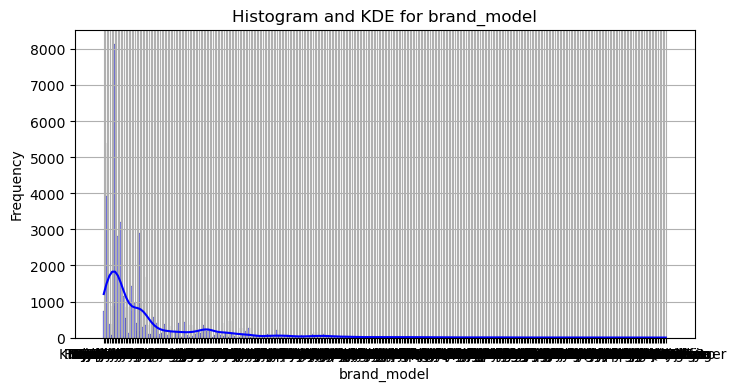

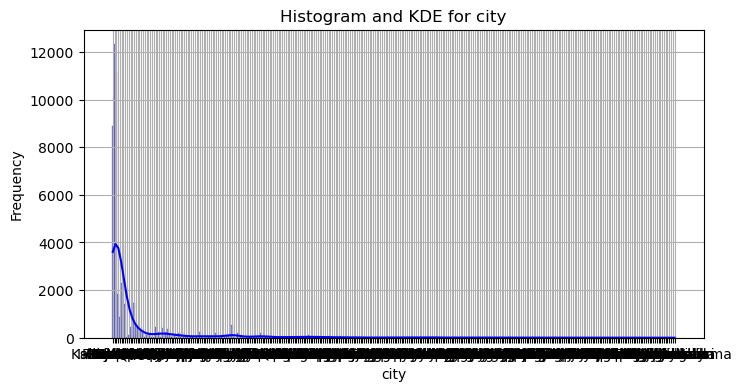

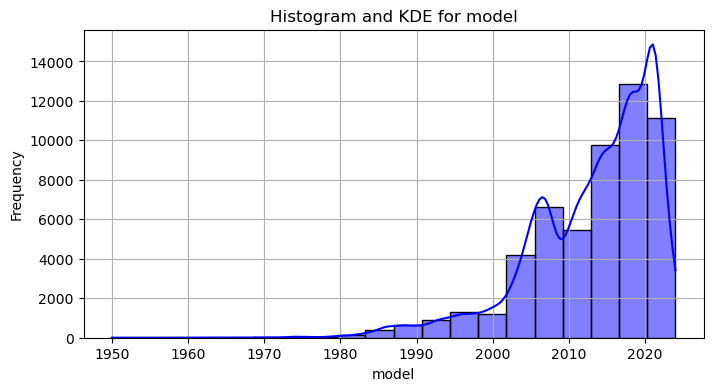

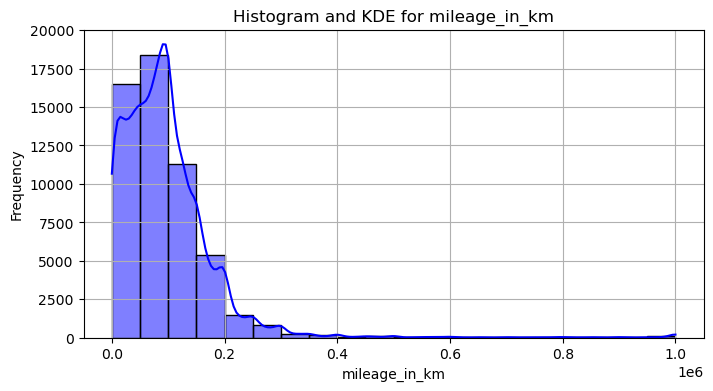

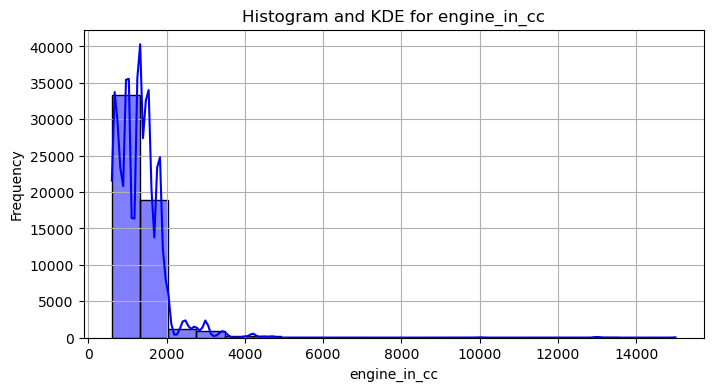

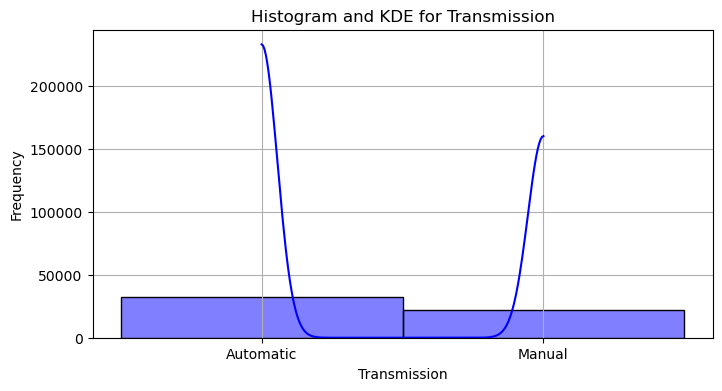

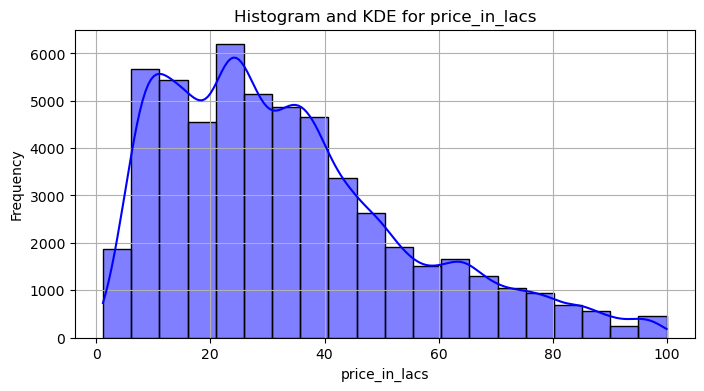

In [1538]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Plot histograms for all columns
for column in df.columns:
    plt.figure(figsize=(8, 4))  # Adjust the size as needed
    sns.histplot(df[column], kde=True, bins=20, color='blue')
    plt.title(f'Histogram and KDE for {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()


# 4) outliers detected in the following columns

- engine_in_cc 
- mileage
- models

In [1539]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5
3,Toyota Hilux,Islamabad,2017,85000,3000.0,Automatic,92.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9


# 4.1)Visualizing Outliers


In [1540]:
import plotly.express as px

# Create an interactive boxplot for mileage_in_km
fig = px.box(
    df, 
    y='mileage_in_km', 
    title='Box Plot of Mileage (in Km)',
    labels={'mileage_in_km': 'Mileage (in Km)'},
    color_discrete_sequence=['#FF5733'],  # Vibrant color
    template='plotly_dark',  # Dark and stylish template
    width=850,
    height=500
)

# Update layout for enhanced style
fig.update_layout(
    title_font=dict(size=22, family='Courier New, monospace', color='#FFD700'),
    yaxis=dict(
        title='Mileage (in Km)',
        title_font=dict(size=16, family='Courier New, monospace', color='#00FF00'),
        tickfont=dict(size=12, color='white'),
        gridcolor='#444'
    ),
    xaxis=dict(
        showticklabels=False,  # Hides x-axis tick labels
        zeroline=False
    ),
    plot_bgcolor='#1E1E1E',  # Custom background color for the plot area
    paper_bgcolor='#1A1A1A',  # Custom background color for the entire figure
    margin=dict(l=50, r=50, t=60, b=40),
    boxmode='group',  # Makes boxplots look neat if adding more categories later
)

# Add styling for hover interactions
fig.update_traces(
    hoverlabel=dict(
        bgcolor='white',
        font_size=14,
        font_family='Rockwell',
        bordercolor='#FF5733'
    )
)

# Show the figure
fig.show()


In [1541]:
# Extract the column
mileage_in_km = df['mileage_in_km']

# Calculate outliers using the IQR method
Q1 = mileage_in_km.quantile(0.25)
Q3 = mileage_in_km.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = mileage_in_km[(mileage_in_km < lower_bound) | (mileage_in_km > upper_bound)]

# Print outliers and their positions
print("Outliers in mileage_in_km:")
print(outliers)

# Show the lower and upper bounds
print("\nLower Bound:", lower_bound)
print("Upper Bound:", upper_bound)

Outliers in mileage_in_km:
80       999900
154      350000
255      326519
313      280000
428      271800
          ...  
59963    300000
59986    300000
60058    290000
60079    990000
60091    435000
Name: mileage_in_km, Length: 1639, dtype: int32

Lower Bound: -84000.0
Upper Bound: 252000.0


### Outliers

The **outliers** in the `mileage_in_km` column begin at **252,000 km**, with a total of **1,639** outlier data points.


In [1542]:
import plotly.express as px

# Create an interactive boxplot for mileage_in_km
fig = px.box(
    df, 
    y='model', 
    title='Box Plot of model',
    labels={'model': 'model'},
    color_discrete_sequence=['#FF5733'],  # Vibrant color
    template='plotly_dark',  # Dark and stylish template
    width=850,
    height=500
)

# Update layout for enhanced style
fig.update_layout(
    title_font=dict(size=22, family='Courier New, monospace', color='#FFD700'),
    yaxis=dict(
        title='model',
        title_font=dict(size=16, family='Courier New, monospace', color='#00FF00'),
        tickfont=dict(size=12, color='white'),
        gridcolor='#444'
    ),
    xaxis=dict(
        showticklabels=False,  # Hides x-axis tick labels
        zeroline=False
    ),
    plot_bgcolor='#1E1E1E',  # Custom background color for the plot area
    paper_bgcolor='#1A1A1A',  # Custom background color for the entire figure
    margin=dict(l=50, r=50, t=60, b=40),
    boxmode='group',  # Makes boxplots look neat if adding more categories later
)

# Add styling for hover interactions
fig.update_traces(
    hoverlabel=dict(
        bgcolor='white',
        font_size=14,
        font_family='Rockwell',
        bordercolor='#FF5733'
    )
)

# Show the figure
fig.show()


In [1543]:
# Extract the column
model = df['model']

# Calculate outliers using the IQR method
Q1 = model.quantile(0.25)
Q3 = model.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = model[(model < lower_bound) | (model > upper_bound)]

# Print outliers and their positions
print("Outliers in mileage_in_km:")
print(outliers)

# Show the lower and upper bounds
print("\nLower Bound:", lower_bound)
print("Upper Bound:", upper_bound)

Outliers in mileage_in_km:
26       1986
524      1988
666      1984
673      1988
1239     1986
         ... 
59963    1988
59966    1974
59978    1986
59980    1986
60079    1989
Name: model, Length: 1116, dtype: int64

Lower Bound: 1990.0
Upper Bound: 2038.0


In [1544]:
import plotly.express as px

# Create an interactive boxplot for mileage_in_km
fig = px.box(
    df, 
    y='engine_in_cc', 
    title='Box Plot of engine_in_cc',
    labels={'engine_in_cc': 'engine_in_cc'},
    color_discrete_sequence=['#FF5733'],  # Vibrant color
    template='plotly_dark',  # Dark and stylish template
    width=850,
    height=500
)

# Update layout for enhanced style
fig.update_layout(
    title_font=dict(size=22, family='Courier New, monospace', color='#FFD700'),
    yaxis=dict(
        title='engine_in_cc',
        title_font=dict(size=16, family='Courier New, monospace', color='#00FF00'),
        tickfont=dict(size=12, color='white'),
        gridcolor='#444'
    ),
    xaxis=dict(
        showticklabels=False,  # Hides x-axis tick labels
        zeroline=False
    ),
    plot_bgcolor='#1E1E1E',  # Custom background color for the plot area
    paper_bgcolor='#1A1A1A',  # Custom background color for the entire figure
    margin=dict(l=50, r=50, t=60, b=40),
    boxmode='group',  # Makes boxplots look neat if adding more categories later
)

# Add styling for hover interactions
fig.update_traces(
    hoverlabel=dict(
        bgcolor='white',
        font_size=14,
        font_family='Rockwell',
        bordercolor='#FF5733'
    )
)

# Show the figure
fig.show()


In [1545]:
# Extract the column
engine_in_cc = df['engine_in_cc']

# Calculate outliers using the IQR method
Q1 = engine_in_cc.quantile(0.25)
Q3 = engine_in_cc.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = engine_in_cc[(engine_in_cc < lower_bound) | (engine_in_cc > upper_bound)]

# Print outliers and their positions
print("Outliers in mileage_in_km:")
print(outliers)

# Show the lower and upper bounds
print("\nLower Bound:", lower_bound)
print("Upper Bound:", upper_bound)

Outliers in mileage_in_km:
3        3000.0
44       2400.0
82       3400.0
177      4200.0
179      2700.0
          ...  
60113    4700.0
60121    2500.0
60125    3000.0
60127    2500.0
60133    2700.0
Name: engine_in_cc, Length: 2514, dtype: float64

Lower Bound: 250.0
Upper Bound: 2250.0


In [1546]:
import plotly.express as px

# Create an interactive boxplot for mileage_in_km
fig = px.box(
    df, 
    y='price_in_lacs', 
    title='Box Plot of price_in_lacs',
    labels={'price_in_lacs': 'price_in_lacs'},
    color_discrete_sequence=['#FF5733'],  # Vibrant color
    template='plotly_dark',  # Dark and stylish template
    width=850,
    height=500
)

# Update layout for enhanced style
fig.update_layout(
    title_font=dict(size=22, family='Courier New, monospace', color='#FFD700'),
    yaxis=dict(
        title='price_in_lacs',
        title_font=dict(size=16, family='Courier New, monospace', color='#00FF00'),
        tickfont=dict(size=12, color='white'),
        gridcolor='#444'
    ),
    xaxis=dict(
        showticklabels=False,  # Hides x-axis tick labels
        zeroline=False
    ),
    plot_bgcolor='#1E1E1E',  # Custom background color for the plot area
    paper_bgcolor='#1A1A1A',  # Custom background color for the entire figure
    margin=dict(l=50, r=50, t=60, b=40),
    boxmode='group',  # Makes boxplots look neat if adding more categories later
)

# Add styling for hover interactions
fig.update_traces(
    hoverlabel=dict(
        bgcolor='white',
        font_size=14,
        font_family='Rockwell',
        bordercolor='#FF5733'
    )
)

# Show the figure
fig.show()


In [1547]:
# Extract the column
price_in_lacs = df['price_in_lacs']

# Calculate outliers using the IQR method
Q1 = price_in_lacs.quantile(0.25)
Q3 = price_in_lacs.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = price_in_lacs[(price_in_lacs < lower_bound) | (price_in_lacs > upper_bound)]

# Print outliers and their positions
print("Outliers in price_in_lacs:")
print(outliers)

# Show the lower and upper bounds
print("\nLower Bound:", lower_bound)
print("Upper Bound:", upper_bound)

Outliers in price_in_lacs:
3        92.0
180      88.5
211      97.0
222      95.0
232      87.0
         ... 
59743    99.8
59749    99.8
59875    90.0
59916    92.0
59940    87.5
Name: price_in_lacs, Length: 1101, dtype: float64

Lower Bound: -25.199999999999992
Upper Bound: 86.79999999999998


# 4.2)Removing Outliers

In [1548]:
# Assuming your DataFrame is df
columns_to_check = ['model', 'mileage_in_km', 'engine_in_cc','price_in_lacs']  # List of columns to check for outliers

# Calculate Q1, Q3, and IQR for each column
Q1 = df[columns_to_check].quantile(0.25)
Q3 = df[columns_to_check].quantile(0.75)
IQR = Q3 - Q1

# Filter out outliers
df = df[~((df[columns_to_check] < (Q1 - 1.5 * IQR)) | (df[columns_to_check] > (Q3 + 1.5 * IQR))).any(axis=1)]


In [1549]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5


In [1550]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 49052 entries, 0 to 60136
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   brand_model    49052 non-null  object 
 1   city           49052 non-null  object 
 2   model          49052 non-null  int64  
 3   mileage_in_km  49052 non-null  int32  
 4   engine_in_cc   49052 non-null  float64
 5   Transmission   49052 non-null  object 
 6   price_in_lacs  49052 non-null  float64
dtypes: float64(2), int32(1), int64(1), object(3)
memory usage: 2.8+ MB


# 4.3) Rows Without Outliers

In [1551]:
# Extract the column
mileage_in_km = df['mileage_in_km']

# Calculate outliers using the IQR method
Q1 = mileage_in_km.quantile(0.25)
Q3 = mileage_in_km.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out the outliers
df = df[(mileage_in_km >= lower_bound) & (mileage_in_km <= upper_bound)]

# Show the DataFrame without outliers
print("DataFrame without outliers:")
df

DataFrame without outliers:


,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5
...,...,...,...,...,...,...,...
60131,Honda Civic,Sialkot,2018,98000,1800.0,Automatic,47.8
60132,Toyota Corolla,Karachi,2015,96000,1300.0,Automatic,35.5
60134,Honda City,Sialkot,2019,32400,1300.0,Manual,37.8
60135,Honda City,Sargodha,2016,70000,1500.0,Automatic,35.5


# 5)Dataframe  Distribuition After Removing Outliers

In [1552]:
import pandas as pd
import plotly.express as px

# Define a list of most-used colors for the plots
color_palette = [
    '#636EFA',  # Blue
    '#EF553B',  # Red
    '#00CC96',  # Green
    '#AB63FA',  # Purple
    '#FFA15A',  # Orange
    '#19D3F3',  # Cyan
    '#FF6692',  # Pink
    '#B6E880',  # Light Green
    '#FF97FF',  # Magenta
    '#FECB52',  # Yellow
]

# Initialize color index
color_index = 0

# Iterate over all columns in the DataFrame to plot histograms with KDE
for column in df.columns:
    # Get the current color from the palette
    current_color = color_palette[color_index % len(color_palette)]
    
    # Generate a histogram with KDE and violin plot
    fig = px.histogram(
        df,
        x=column,
        nbins=20,  # Number of bins
        marginal="violin",  # Add a violin plot for KDE-like visualization
        title=f"Distribution of {column} with Histogram and KDE",
        labels={column: column},  # Set the x-axis label
        template="plotly_white",  # Clean, professional template
        color_discrete_sequence=[current_color],  # Apply the color
    )
    
    # Customize the layout for better aesthetics
    fig.update_layout(
        title_font=dict(size=18, family="Arial, sans-serif", color="black"),  # Title font style
        xaxis_title=column,  # X-axis title
        yaxis_title="Frequency",  # Y-axis title
        bargap=0.1,  # Set bar gap for clarity
        margin=dict(l=50, r=50, t=50, b=50),  # Add padding
    )
    
    # Show the plot
    fig.show()
    
    # Increment the color index for the next column
    color_index += 1


In [1553]:
df['price_in_lacs'].min()

1.8

In [1554]:
df['price_in_lacs'].mean()

32.4625272555231

In [1555]:
df['price_in_lacs'].max()

86.5

In [1556]:
df['price_in_lacs'].value_counts()

price_in_lacs
35.0    465
25.0    421
40.0    414
24.0    410
23.0    401
       ... 
82.3      1
84.1      1
66.6      1
71.3      1
73.3      1
Name: count, Length: 766, dtype: int64

In [1557]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5


# 6)Feature Engineering

In [1558]:
# make a new column called brand_model age based on the model column
df['brand_model_age'] = 2024 - df['model']

In [1559]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12


In [1560]:
# 1. make a column with price_type based on the price_in_lacs column if price_in_lacs from 0 to 20 make it budget if from 20 to 40 make it mid range and from 40 to 60 make it premium and from 60 to 80 make it luxury
df['price_type'] = pd.cut(df['price_in_lacs'], bins=[0, 20, 40, 60, 86.5], 
                          labels=['Budget', 'Mid Range', 'Premium', 'Luxury'])

In [1561]:
# 2. Bucketizing mileage_in_km
bins = [0, 100000, 200000, 239000]
labels = ['Low', 'Medium', 'High']
df['mileage_category'] = pd.cut(df['mileage_in_km'], bins=bins, labels=labels)

In [1562]:


# 3. Interaction Features
df['engine_mileage_interaction'] = df['engine_in_cc'] * df['mileage_in_km']


In [1563]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


# 7) EDA: Exploratory Data Analysis


In [1564]:
df["brand_model"].value_counts().head(10)

brand_model
Toyota Corolla    7266
Honda Civic       4955
Honda City        3726
Suzuki Mehran     3059
Suzuki Cultus     2841
Suzuki Alto       2731
Suzuki Wagon      1653
Toyota Vitz       1387
Toyota Yaris      1161
Daihatsu Mira     1150
Name: count, dtype: int64

In [1565]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 48614 entries, 0 to 60136
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   brand_model                 48614 non-null  object  
 1   city                        48614 non-null  object  
 2   model                       48614 non-null  int64   
 3   mileage_in_km               48614 non-null  int32   
 4   engine_in_cc                48614 non-null  float64 
 5   Transmission                48614 non-null  object  
 6   price_in_lacs               48614 non-null  float64 
 7   brand_model_age             48614 non-null  int64   
 8   price_type                  48614 non-null  category
 9   mileage_category            48614 non-null  category
 10  engine_mileage_interaction  48614 non-null  float64 
dtypes: category(2), float64(3), int32(1), int64(2), object(3)
memory usage: 3.6+ MB


In [1566]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


In [1567]:
df["city"].value_counts().head(10)

city
Lahore        11090
Karachi       10166
Islamabad      7668
Rawalpindi     3390
Peshawar       1938
Faisalabad     1666
Multan         1331
Gujranwala     1308
Sialkot         786
Sargodha        496
Name: count, dtype: int64

In [1568]:
df['model'].value_counts().head(10)

model
2021    5193
2018    3624
2022    3335
2019    3016
2017    2850
2020    2831
2015    2562
2014    2487
2016    2413
2007    2017
Name: count, dtype: int64

In [1569]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


In [1570]:
df['engine_in_cc'].value_counts().head(10)

engine_in_cc
1000.0    9143
1300.0    8804
660.0     7205
1500.0    6812
1800.0    6052
800.0     3634
1600.0    2200
2000.0    1510
1200.0    1191
796.0      928
Name: count, dtype: int64

In [1571]:
df['price_in_lacs'].value_counts().head(10)

price_in_lacs
35.0    465
25.0    421
40.0    414
24.0    410
23.0    401
22.5    400
22.0    392
30.0    384
38.0    367
26.5    361
Name: count, dtype: int64

In [1572]:
df["price_in_lacs"].mean()

32.4625272555231

# Top 10 Car Brands with Most Listings:

In [1573]:
import plotly.express as px

# Get the top 10 car brands by count
top_titles = df['brand_model'].value_counts().head(10).reset_index()
top_titles.columns = ['Car Brand Model', 'Number of Listings']

# Create a horizontal bar chart
fig = px.bar(
    top_titles,
    x='Number of Listings',
    y='Car Brand Model',
    text='Number of Listings',
    title='Top 10 Car Brands with Most Listings',
    labels={'Number of Listings': 'Number of Listings', 'Car Brand Model': 'Car Brand Model'},
    orientation='h',  # Horizontal bar chart
    color='Number of Listings',  # Color by the number of listings for a professional gradient
    color_continuous_scale='Viridis',  # Color scale for better aesthetics
)

# Enhance the layout for a polished, professional appearance
fig.update_layout(
    title={
        'text': 'Top 10 Car Brands with Most Listings',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial', color='black')
    },
    xaxis=dict(
        title='Number of Listings',
        title_font=dict(size=14),
        tickfont=dict(size=12),
        showgrid=True,  # Grid for better readability
        gridwidth=1,
        gridcolor='LightGray'
    ),
    yaxis=dict(
        title='Car Brand Model',
        title_font=dict(size=14),
        tickfont=dict(size=12),
        categoryorder='total ascending',
    ),
    margin=dict(l=100, r=50, t=70, b=50),  # Adjust margins for better spacing
    height=550,
    width=1000
)

# Update traces for clarity and a professional finish
fig.update_traces(
    texttemplate='%{x}',  # Show the count on the bars
    textposition='outside',  # Position the text outside the bars
    marker_line_width=1.5,  # Add border around the bars
    marker_line_color='black'  # Set a distinct border color
)

# Show the final plot
fig.show()

# Print the top 10 car brands and their listings counts
print("Top 10 Car Brands with Most Listings:")
for index, row in top_titles.iterrows():
    print(f"Car Brand Model: {row['Car Brand Model']}, Number of Listings: {row['Number of Listings']}")


Top 10 Car Brands with Most Listings:
Car Brand Model: Toyota Corolla, Number of Listings: 7266
Car Brand Model: Honda Civic, Number of Listings: 4955
Car Brand Model: Honda City, Number of Listings: 3726
Car Brand Model: Suzuki Mehran, Number of Listings: 3059
Car Brand Model: Suzuki Cultus, Number of Listings: 2841
Car Brand Model: Suzuki Alto, Number of Listings: 2731
Car Brand Model: Suzuki Wagon, Number of Listings: 1653
Car Brand Model: Toyota Vitz, Number of Listings: 1387
Car Brand Model: Toyota Yaris, Number of Listings: 1161
Car Brand Model: Daihatsu Mira, Number of Listings: 1150


# Top 10 Cities with Most Cars:

In [1574]:
import plotly.express as px

# Get the top 10 cities by count
top_cities = df['city'].value_counts().head(10).reset_index()
top_cities.columns = ['City', 'Count']

# Create a horizontal bar chart
fig = px.bar(
    top_cities,
    x='Count',
    y='City',
    text='Count',
    title='Top 10 Cities with Most Cars',
    labels={'Count': 'Number of Cars', 'City': 'City'},
    orientation='h',  # Horizontal bar chart
    color_discrete_sequence=['#1f77b4']  # Professional color (blue)
)

# Enhance the layout
fig.update_layout(
    title={
        'text': 'Top 10 Cities with Most Cars',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial')
    },
    xaxis=dict(title='Number of Cars', title_font=dict(size=14), tickfont=dict(size=12)),
    yaxis=dict(title='City', title_font=dict(size=14), tickfont=dict(size=12), categoryorder='total ascending'),
    margin=dict(l=100, r=50, t=70, b=50),  # Adjust margins for better spacing
    height=550,
    width=1050
)

# Update bar traces for a clean look
fig.update_traces(
    texttemplate='%{x}',  # Show the count on the bars
    textposition='outside',  # Place text outside the bars
    marker_line_width=1.5,  # Add border to bars
    marker_line_color='black'  # Border color
)

# Display the chart
fig.show()

# Print the top 10 cities and their car counts
print("Top 10 Cities with Most Cars:")
for index, row in top_cities.iterrows():
    print(f"City: {row['City']}, Number of Cars: {row['Count']}")


Top 10 Cities with Most Cars:
City: Lahore, Number of Cars: 11090
City: Karachi, Number of Cars: 10166
City: Islamabad, Number of Cars: 7668
City: Rawalpindi, Number of Cars: 3390
City: Peshawar, Number of Cars: 1938
City: Faisalabad, Number of Cars: 1666
City: Multan, Number of Cars: 1331
City: Gujranwala, Number of Cars: 1308
City: Sialkot, Number of Cars: 786
City: Sargodha, Number of Cars: 496


# Distribution of Cars Top 10 Cities and Top 10 Brand Models:

In [1575]:
import plotly.express as px

# Get the top 10 cities and top 10 brand models
top_cities = df['city'].value_counts().index[:10].tolist()
top_brands = df['brand_model'].value_counts().index[:10].tolist()

# Filter the dataframe for the top cities and brand models
df_top = df[df['city'].isin(top_cities) & df['brand_model'].isin(top_brands)]

# Create a treemap visualization with a professional design
fig = px.treemap(
    df_top,
    path=['city', 'brand_model'],
    title='Distribution of Cars: Top 10 Cities and Top 10 Brand Models',
    color='brand_model',
    color_discrete_sequence=px.colors.qualitative.Set2,  # Use a professional color palette
    labels={'city': 'City', 'brand_model': 'Brand Model'}
)

# Customize the layout for a professional appearance
fig.update_layout(
    title={
        'text': 'Distribution of Cars: Top 10 Cities and Top 10 Brand Models',
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(size=20, family='Arial')
    },
    margin=dict(t=50, l=25, r=25, b=25),  # Adjust margins for a cleaner look
    coloraxis_colorbar=dict(
        title="Brand Models",
        len=0.6,  # Adjust length of the colorbar
        ticks="outside"
    )
)

# Enhance the hover text for detailed information
fig.update_traces(
    hovertemplate='<b>City:</b> %{label}<br><b>Cars:</b> %{value}'
)

# Show the figure
fig.show()

# Print the top 10 cities and their associated brand models with car counts
print("Top 10 Cities with Top 10 Brand Models:")
for city in top_cities:
    city_data = df_top[df_top['city'] == city]
    if not city_data.empty:
        print(f"\nCity: {city}")
        for brand in top_brands:
            brand_data = city_data[city_data['brand_model'] == brand]
            if not brand_data.empty:
                print(f"  Brand Model: {brand}, Total Cars: {brand_data.shape[0]}")


Top 10 Cities with Top 10 Brand Models:

City: Lahore
  Brand Model: Toyota Corolla, Total Cars: 1174
  Brand Model: Honda Civic, Total Cars: 1281
  Brand Model: Honda City, Total Cars: 1046
  Brand Model: Suzuki Mehran, Total Cars: 498
  Brand Model: Suzuki Cultus, Total Cars: 665
  Brand Model: Suzuki Alto, Total Cars: 468
  Brand Model: Suzuki Wagon, Total Cars: 464
  Brand Model: Toyota Vitz, Total Cars: 262
  Brand Model: Toyota Yaris, Total Cars: 317
  Brand Model: Daihatsu Mira, Total Cars: 163

City: Karachi
  Brand Model: Toyota Corolla, Total Cars: 1355
  Brand Model: Honda Civic, Total Cars: 933
  Brand Model: Honda City, Total Cars: 594
  Brand Model: Suzuki Mehran, Total Cars: 300
  Brand Model: Suzuki Cultus, Total Cars: 581
  Brand Model: Suzuki Alto, Total Cars: 643
  Brand Model: Suzuki Wagon, Total Cars: 210
  Brand Model: Toyota Vitz, Total Cars: 319
  Brand Model: Toyota Yaris, Total Cars: 348
  Brand Model: Daihatsu Mira, Total Cars: 611

City: Islamabad
  Brand Mo

In [1576]:
#which model his the most cars
model_most_cars = df['model'].value_counts().idxmax()
print(f'The model that sold the most cars is: {model_most_cars}')

The model that sold the most cars is: 2021


# Top 10 Car Models with Most Cars:

In [1577]:
import plotly.graph_objects as go

# Get the top 10 models by count
top_10_models = df['model'].value_counts().head(10).reset_index()
top_10_models.columns = ['Model', 'Count']

# Create a pie chart for the top 10 models
fig = go.Figure(
    data=[
        go.Pie(
            labels=top_10_models['Model'],
            values=top_10_models['Count'],
            hoverinfo='label+percent+value',
            textinfo='label+percent',
            textfont=dict(size=14),
            marker=dict(line=dict(color='#000000', width=2))  # Black border for better visibility
        )
    ]
)

# Add a professional title
fig.update_layout(
    title={
        'text': 'Top 10 Car Models with Most Cars',
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(size=20, family='Arial')
    },
    margin=dict(t=50, l=50, r=50, b=50)
)

# Display the chart
fig.show()

# Print the top 10 models and their counts
print("Top 10 Car Models with Most Cars:")
for index, row in top_10_models.iterrows():
    print(f"Model: {row['Model']}, Count: {row['Count']}")


Top 10 Car Models with Most Cars:
Model: 2021, Count: 5193
Model: 2018, Count: 3624
Model: 2022, Count: 3335
Model: 2019, Count: 3016
Model: 2017, Count: 2850
Model: 2020, Count: 2831
Model: 2015, Count: 2562
Model: 2014, Count: 2487
Model: 2016, Count: 2413
Model: 2007, Count: 2017


# Top 10 Brands with Most Cars of Top 10 Models of top 10 most cars cities
- it cover the details of Top 10 Brands

# the count of each brand is less beacuse it didnt include all models or cities and brandmodels

In [1578]:
import plotly.express as px
from plotly.colors import qualitative

# Extract top 10 models and top 10 brand models
top_models = df['model'].value_counts().head(10).index.tolist()
top_brands = df['brand_model'].value_counts().head(10).index.tolist()

# Filter the dataset to include only the top 10 models and top 10 brand models
df_top = df[df['model'].isin(top_models) & df['brand_model'].isin(top_brands)]

# Identify the top model
top_model = top_models[0]

# Define custom color mapping: highlight top model with a standout color, others with a muted palette
color_discrete_map = {model: '#FF5733' if model == top_model else '#AED6F1' for model in top_models}

# Create a treemap visualization
fig = px.treemap(
    df_top, 
    path=['brand_model', 'model', 'city'], 
    title='Top 10 Brands with Most Cars of Top 10 Models Sold',
    color='model',  # Color by car model
    color_discrete_map=color_discrete_map,  # Apply custom color mapping
    hover_data={'brand_model': True, 'model': True, 'city': True}
)

# Customize layout for a professional appearance
fig.update_layout(
    title={
        'text': 'Top 10 Brands with Most Cars Sold Across Top 10 Models and Cities',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial', color='black')
    },
    margin=dict(t=50, b=50, l=50, r=50),
    height=600,
    width=1000
)

# Enhance trace appearance
fig.update_traces(
    texttemplate='%{label}',
    textposition='middle center',
    marker=dict(line=dict(color="white", width=2))
)

# Display the treemap
fig.show()


# Top 10 Cities with Most Cars of Top 10 Models Sold

In [1579]:
import plotly.express as px

# Get the top 10 cities and top 10 models
top_cities = df['city'].value_counts().index[:10].tolist()
top_models = df['model'].value_counts().index[:10].tolist()

# Filter the dataset to include only the top 10 cities and models
df_top = df[df['city'].isin(top_cities) & df['model'].isin(top_models)]

# Create a treemap with professional enhancements
fig = px.treemap(
    df_top, 
    path=['city', 'model'], 
    title='Top 10 Cities with Most Cars of Top 10 Models Sold',
    color='model',  # Color by model for better differentiation
    color_continuous_scale='Viridis',  # Use a professional color scale
    hover_data={'city': True, 'model': True}  # Add relevant info to hover
)

# Enhance the layout for a more professional appearance
fig.update_layout(
    title={
        'text': 'Top 10 Cities with Most Cars of Top 10 Models Sold',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial', color='black')
    },
    margin=dict(t=50, b=50, l=50, r=50),  # Adjust margins for better spacing
    coloraxis_colorbar=dict(
        title='Car Model',
        tickvals=[0, 1],  # Adjust color bar ticks if needed
        ticktext=['Low', 'High']
    ),
    height=600,
    width=1000
)

# Update the trace for a clean professional look
fig.update_traces(
    texttemplate='%{label}',  # Display the label of the node
    textposition='middle center',  # Place text in the middle of the node
    marker=dict(line=dict(color="white", width=2))  # Add white border for clean edges
)

# Show the updated treemap
fig.show()

# Print the top 10 cities and models with the count of cars
print("Top 10 Cities with Most Cars of Top 10 Models Sold:")
for city in top_cities:
    city_data = df_top[df_top['city'] == city]
    for model in top_models:
        model_data = city_data[city_data['model'] == model]
        if not model_data.empty:
            print(f"City: {city}, Model: {model}, Number of Cars: {model_data.shape[0]}")


Top 10 Cities with Most Cars of Top 10 Models Sold:
City: Lahore, Model: 2021, Number of Cars: 1372
City: Lahore, Model: 2018, Number of Cars: 822
City: Lahore, Model: 2022, Number of Cars: 869
City: Lahore, Model: 2019, Number of Cars: 788
City: Lahore, Model: 2017, Number of Cars: 718
City: Lahore, Model: 2020, Number of Cars: 770
City: Lahore, Model: 2015, Number of Cars: 550
City: Lahore, Model: 2014, Number of Cars: 500
City: Lahore, Model: 2016, Number of Cars: 566
City: Lahore, Model: 2007, Number of Cars: 389
City: Karachi, Model: 2021, Number of Cars: 1397
City: Karachi, Model: 2018, Number of Cars: 825
City: Karachi, Model: 2022, Number of Cars: 807
City: Karachi, Model: 2019, Number of Cars: 651
City: Karachi, Model: 2017, Number of Cars: 472
City: Karachi, Model: 2020, Number of Cars: 625
City: Karachi, Model: 2015, Number of Cars: 564
City: Karachi, Model: 2014, Number of Cars: 588
City: Karachi, Model: 2016, Number of Cars: 467
City: Karachi, Model: 2007, Number of Cars: 

# Top 10 Brand Models with Most Mileage

In [1580]:
import plotly.express as px

# Get the top 10 brand models by count
top_brand_models = df['brand_model'].value_counts().index[:10].tolist()

# Filter data for top brand models
df_top = df[df['brand_model'].isin(top_brand_models)]

# Create a scatter plot with professional adjustments
fig = px.scatter(
    df_top,
    x='mileage_in_km',
    y='brand_model',
    color='brand_model',
    hover_data={'model': True, 'mileage_in_km': True},  # Add mileage to the hover data
    title='Top 10 Brand Models with Most Mileage',
    labels={'mileage_in_km': 'Mileage (in km)', 'brand_model': 'Brand Model'},
    color_continuous_scale='Blues',  # Use a professional color scale
    template='plotly_dark'  # Use a dark theme for a modern look
)

# Enhance the layout for clarity and professionalism
fig.update_layout(
    title={
        'text': 'Top 10 Brand Models with Most Mileage',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial', color='white')
    },
    xaxis=dict(
        title='Mileage (in km)',
        showgrid=True,  # Show grid lines for better clarity
        gridcolor='gray'  # Use gray gridlines for better contrast
    ),
    yaxis=dict(
        title='Brand Model',
        showgrid=True,
        gridcolor='gray'  # Gray gridlines for better contrast
    ),
    margin=dict(t=50, b=50, l=50, r=50),  # Adjust margins for better spacing
    height=600,
    width=1000
)

# Update the trace for a more polished appearance
fig.update_traces(
    marker=dict(line=dict(color="black", width=1)),  # Add a black border around markers
    opacity=0.8  # Adjust opacity for better clarity
)

# Show the updated scatter plot
fig.show()


In [1581]:
#print top 10 model with the TOP 10 highest mileage 
top_models = df['model'].value_counts().index[:10].tolist()
df_top = df[df['model'].isin(top_models)]
top_10_models = df_top.groupby('model')['mileage_in_km'].max().sort_values(ascending=False).index[:10].tolist()
print(f'Top 10 Models with Highest Mileage: {top_10_models}')



Top 10 Models with Highest Mileage: [2007, 2015, 2017, 2019, 2014, 2016, 2018, 2020, 2021, 2022]


# Top 10 Brand Models with the Highest Total Mileage:

In [1582]:
import plotly.express as px

# Group by brand_model and calculate the total mileage for each
brand_model_mileage = df.groupby('brand_model', as_index=False)['mileage_in_km'].sum()

# Get the top 10 brand models with the highest total mileage
top_10_brand_models = brand_model_mileage.sort_values(by='mileage_in_km', ascending=False).head(10)

# Format mileage in billions (B) and millions (M)
def format_mileage(mileage):
    if mileage >= 1e9:
        return f"{mileage / 1e9:.1f}B"
    elif mileage >= 1e6:
        return f"{mileage / 1e6:.1f}M"
    else:
        return f"{mileage:.0f}"

# Apply the formatting function to the 'mileage_in_km' column
top_10_brand_models['formatted_mileage'] = top_10_brand_models['mileage_in_km'].apply(format_mileage)

# Create a bar plot to visualize the top 10 brand models with the highest total mileage
fig = px.bar(
    top_10_brand_models, 
    x='brand_model', 
    y='mileage_in_km', 
    title="Top 10 Brand Models with the Highest Total Mileage",
    labels={'mileage_in_km': 'Total Mileage (in km)', 'brand_model': 'Brand Model'},
    text='formatted_mileage'  # Display formatted mileage as text on the bars
)

# Update bar aesthetics
fig.update_traces(
    textposition='outside', 
    textfont=dict(size=7),
    marker_line_width=2,
    marker_line_color='black'
)

# Enhance layout
fig.update_layout(
    xaxis_tickangle=45,  # Rotate x-axis labels for readability
    title_font_size=18
)

fig.show()

# Print the top 10 brand models with formatted mileage
print("Top 10 Brand Models with the Highest Total Mileage:\n")
for index, row in top_10_brand_models.iterrows():
    brand_model = row['brand_model']
    mileage = row['formatted_mileage']
    print(f"Brand Model: {brand_model} | Total Mileage: {mileage} km")


Top 10 Brand Models with the Highest Total Mileage:

Brand Model: Toyota Corolla | Total Mileage: 733.1M km
Brand Model: Honda Civic | Total Mileage: 508.8M km
Brand Model: Honda City | Total Mileage: 362.1M km
Brand Model: Suzuki Cultus | Total Mileage: 220.4M km
Brand Model: Suzuki Mehran | Total Mileage: 214.5M km
Brand Model: Suzuki Alto | Total Mileage: 176.9M km
Brand Model: Toyota Vitz | Total Mileage: 149.6M km
Brand Model: Suzuki Wagon | Total Mileage: 120.8M km
Brand Model: Toyota Prius | Total Mileage: 99.1M km
Brand Model: Toyota Aqua | Total Mileage: 83.5M km


In [1583]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


In [1584]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 48614 entries, 0 to 60136
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   brand_model                 48614 non-null  object  
 1   city                        48614 non-null  object  
 2   model                       48614 non-null  int64   
 3   mileage_in_km               48614 non-null  int32   
 4   engine_in_cc                48614 non-null  float64 
 5   Transmission                48614 non-null  object  
 6   price_in_lacs               48614 non-null  float64 
 7   brand_model_age             48614 non-null  int64   
 8   price_type                  48614 non-null  category
 9   mileage_category            48614 non-null  category
 10  engine_mileage_interaction  48614 non-null  float64 
dtypes: category(2), float64(3), int32(1), int64(2), object(3)
memory usage: 3.6+ MB


In [1585]:
#which engine_in_cc has the most cars
engine_most_cars = df['engine_in_cc'].value_counts().idxmax()
print(f'The engine that sold the most cars is: {engine_most_cars}')

The engine that sold the most cars is: 1000.0


# Top 10 Engine Sizes with the Most Cars:

In [1586]:
import plotly.express as px

# Calculate counts for each engine size
engine_counts = df['engine_in_cc'].value_counts().reset_index()
engine_counts.columns = ['engine_in_cc', 'count']

# Get the top 10 engine sizes
top_10_engine_counts = engine_counts.head(10)

# Plot the bar chart for top 10 engine sizes
fig = px.bar(
    top_10_engine_counts,
    x='engine_in_cc',
    y='count',
    title='Top 10 Engine Sizes with the Most Cars',
    labels={'engine_in_cc': 'Engine (CC)', 'count': 'Number of Cars'},
    text='count',
    color='count',  # Color bars based on the count for better distinction
    color_continuous_scale='Blues',  # Light color scale for a professional look
    template='plotly_white'  # Light theme for a clean modern look
)

# Highlight the engine with the most cars in the top 10
engine_most_cars = top_10_engine_counts['engine_in_cc'].iloc[0]
fig.add_shape(
    type='line',
    x0=engine_most_cars, x1=engine_most_cars,
    y0=0, y1=top_10_engine_counts['count'].max(),
    line=dict(color='red', dash='dash', width=2)  # Red dashed line for emphasis
)

# Update layout and styling for a more professional look
fig.update_layout(
    title={
        'text': 'Top 10 Engine Sizes with the Most Cars',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial', color='black')
    },
    xaxis=dict(
        title='Engine (CC)',
        showgrid=True,
        gridcolor='lightgray'  # Light gray gridlines for better contrast
    ),
    yaxis=dict(
        title='Number of Cars',
        showgrid=False,  # Hide gridlines for a cleaner look
        showticklabels=True
    ),
    margin=dict(t=50, b=50, l=50, r=50),  # Adjust margins for better spacing
    height=600,
    width=1000
)

# Update the trace for a professional appearance
fig.update_traces(
    textposition='outside',
    marker=dict(line=dict(color="black", width=1)),  # Add black borders around bars
    opacity=0.9  # Adjust opacity for better clarity
)

# Show the updated bar chart
fig.show()

# For printing the results
print(f"Top 10 Engine Sizes with the Most Cars:")
for index, row in top_10_engine_counts.iterrows():
    print(f"Engine Size: {row['engine_in_cc']} CC, Number of Cars: {row['count']}")


Top 10 Engine Sizes with the Most Cars:
Engine Size: 1000.0 CC, Number of Cars: 9143.0
Engine Size: 1300.0 CC, Number of Cars: 8804.0
Engine Size: 660.0 CC, Number of Cars: 7205.0
Engine Size: 1500.0 CC, Number of Cars: 6812.0
Engine Size: 1800.0 CC, Number of Cars: 6052.0
Engine Size: 800.0 CC, Number of Cars: 3634.0
Engine Size: 1600.0 CC, Number of Cars: 2200.0
Engine Size: 2000.0 CC, Number of Cars: 1510.0
Engine Size: 1200.0 CC, Number of Cars: 1191.0
Engine Size: 796.0 CC, Number of Cars: 928.0


# Top 10 Engine Sizes with the Highest Total Mileage:

In [1587]:
import plotly.express as px

# Grouping by engine size and calculating the total mileage for each engine size
engine_total_mileage = df.groupby('engine_in_cc', as_index=False)['mileage_in_km'].sum()

# Sorting to get the top 10 engine sizes with the highest total mileage
top_10_engines = engine_total_mileage.sort_values(by='mileage_in_km', ascending=False).head(10)

# Function to format numbers in short form (B for billion, M for million)
def format_number(number):
    if number >= 1e9:
        return f"{number / 1e9:.2f}B"
    elif number >= 1e6:
        return f"{number / 1e6:.2f}M"
    return f"{number:.0f}"

# Apply formatting directly to display text
top_10_engines['mileage_text'] = top_10_engines['mileage_in_km'].apply(format_number)

# Create a bar chart to visualize the total mileage
fig = px.bar(
    top_10_engines,
    x='engine_in_cc',
    y='mileage_in_km',
    title="Top 10 Engine Sizes with the Highest Total Mileage",
    labels={'mileage_in_km': 'Total Mileage', 'engine_in_cc': 'Engine Size (CC)'},
    text='mileage_text',  # Show the formatted mileage in the chart
    color='mileage_in_km',  # Color bars based on total mileage
    color_continuous_scale='Blues',  # Light color scale
    template='plotly_white'  # Clean and modern theme
)

# Highlight the engine size with the highest total mileage
engine_highest_mileage = top_10_engines['engine_in_cc'].iloc[0]
fig.add_shape(
    type='line',
    x0=engine_highest_mileage, x1=engine_highest_mileage,
    y0=0, y1=top_10_engines['mileage_in_km'].max(),
    line=dict(color='red', dash='dash', width=2)  # Red dashed line for emphasis
)

# Update layout and styling for better presentation
fig.update_layout(
    title={
        'text': 'Top 10 Engine Sizes with the Highest Total Mileage',
        'x': 0.5,
        'xanchor': 'center',
        'font': dict(size=20, family='Arial', color='black')
    },
    xaxis=dict(title='Engine Size (CC)', showgrid=True, gridcolor='lightgray'),
    yaxis=dict(title='Total Mileage', showgrid=False),
    margin=dict(t=50, b=50, l=50, r=50),
    height=600,
    width=1000
)

fig.update_traces(
    textposition='outside',
    marker=dict(line=dict(color="black", width=1)),
    opacity=0.9
)

fig.show()

# Print the results in short form
print("Top 10 Engine Sizes with the Highest Total Mileage:")
for _, row in top_10_engines.iterrows():
    print(f"Engine Size: {row['engine_in_cc']} CC | Total Mileage: {format_number(row['mileage_in_km'])}")


Top 10 Engine Sizes with the Highest Total Mileage:
Engine Size: 1300.0 CC | Total Mileage: 939.63M
Engine Size: 1000.0 CC | Total Mileage: 742.77M
Engine Size: 1800.0 CC | Total Mileage: 595.45M
Engine Size: 1500.0 CC | Total Mileage: 574.16M
Engine Size: 660.0 CC | Total Mileage: 467.19M
Engine Size: 800.0 CC | Total Mileage: 261.68M
Engine Size: 1600.0 CC | Total Mileage: 224.19M
Engine Size: 2000.0 CC | Total Mileage: 97.57M
Engine Size: 796.0 CC | Total Mileage: 60.67M
Engine Size: 1200.0 CC | Total Mileage: 44.07M


In [1588]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


# Distribution of Cars by Transmission Type:

In [1589]:
import plotly.express as px

# Calculate the number of cars for each transmission type
transmission_counts = df['Transmission'].value_counts().reset_index()
transmission_counts.columns = ['Transmission Type', 'Number of Cars']  # Rename columns for clarity

# Create a pie chart to visualize the distribution of cars by transmission type
fig = px.pie(
    transmission_counts,
    names='Transmission Type',
    values='Number of Cars',
    title='Distribution of Cars by Transmission Type',
    labels={'Transmission Type': 'Transmission Type', 'Number of Cars': 'Number of Cars'},
    color_discrete_sequence=px.colors.sequential.Viridis
)

# Enhance chart appearance
fig.update_traces(
    textinfo='percent+label',  # Display percentage and label
    textfont_size=14,          # Set text font size for better readability
    pull=[0.1 if i == 0 else 0 for i in range(len(transmission_counts))]  # Highlight the largest segment
)

# Improve overall layout
fig.update_layout(
    title_font_size=18,
    title_x=0.5  # Center-align the title
)

# Display the pie chart
fig.show()

# Print the details of transmission distribution
print("Distribution of Cars by Transmission Type:\n")
for _, row in transmission_counts.iterrows():
    print(f"Transmission Type: {row['Transmission Type']} | Number of Cars: {row['Number of Cars']}")


Distribution of Cars by Transmission Type:

Transmission Type: Automatic | Number of Cars: 29069
Transmission Type: Manual | Number of Cars: 19545


# now start with price columns explore it 1 pm 1/6/25

In [1590]:
#print price_in_lacs with top min and max values
df['price_in_lacs'].describe()

count    48614.000000
mean        32.462527
std         19.010034
min          1.800000
25%         17.400000
50%         29.200000
75%         43.500000
max         86.500000
Name: price_in_lacs, dtype: float64

In [1591]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


# Thats why i choose top 10 

In [1592]:
percentage = (df['city'].value_counts().head(10).sum() / df.shape[0]) * 100
print(f"Percentage of top 10 cities: {percentage:.2f}%")

Percentage of top 10 cities: 81.95%


In [1593]:
percentage = (df['brand_model'].value_counts().head(10).sum() / df.shape[0]) * 100
print(f"Percentage of top 10 brand_model: {percentage:.2f}%")

Percentage of top 10 brand_model: 61.56%


In [1594]:
percentage = (df['model'].value_counts().head(10).sum() / df.shape[0]) * 100
print(f"Percentage of top 10 models: {percentage:.2f}%")

Percentage of top 10 models: 62.39%


In [1595]:
# Import necessary libraries
import pandas as pd
import plotly.express as px

# Data Preprocessing: Remove rows with missing values in critical columns
df.dropna(subset=["price_in_lacs", "city", "brand_model", "model"], inplace=True)

# Group by city and calculate the number of cars in each city
city_counts = df.groupby("city").size().reset_index(name="Count")

# Sort the cities by the number of cars and select the top 10 cities
top_10_cities = city_counts.sort_values(by="Count", ascending=False).head(10)["city"]

# Filter the dataset to include only the top 10 cities with the highest number of cars
df_top_10_cities = df[df["city"].isin(top_10_cities)]

# Calculate the average price of cars in each of the top 10 cities
avg_price_per_city = df_top_10_cities.groupby("city")["price_in_lacs"].mean().reset_index(name="Average_Price")

# Create a box plot of car prices for the top 10 cities using Plotly
fig = px.box(
    df_top_10_cities,
    x="city",
    y="price_in_lacs",
    title="Distribution of Car Prices in the Top 10 Cities with the Most Cars",
    labels={"price_in_lacs": "Price (in Lacs)", "city": "City"},
    template="plotly",
    color="city",  # Color by city for better distinction
    color_discrete_sequence=px.colors.qualitative.Plotly  # Vibrant color palette
)

# Add average car price as scatter markers over the box plot with a bold color
fig.add_scatter(
    x=avg_price_per_city["city"],
    y=avg_price_per_city["Average_Price"],
    mode="markers",
    name="Average Price",
    marker=dict(color="red", size=12, symbol="diamond", line=dict(width=2, color="black"))
)

# Update layout for better aesthetics
fig.update_layout(
    xaxis_tickangle=-45,  # Rotate x-axis labels for better legibility
    title_font=dict(size=20, family="Arial, sans-serif", color="black"),
    xaxis_title="City",
    yaxis_title="Price in Lacs",
    margin=dict(l=50, r=50, t=60, b=40),  # Adjust margins for aesthetics
    plot_bgcolor="#f5f5f5"  # Light grey background for clean appearance
)

# Display the plot
fig.show()


In [1596]:
# Import necessary libraries
import pandas as pd
import plotly.express as px

# Data Preprocessing: Remove rows with missing values in critical columns
df.dropna(subset=["price_in_lacs", "brand_model", "model"], inplace=True)

# Group by brand_model and calculate the number of cars for each
brand_model_counts = df.groupby("brand_model").size().reset_index(name="Count")

# Sort the brand_model by the number of cars and select the top 10
top_10_brand_models = brand_model_counts.sort_values(by="Count", ascending=False).head(10)["brand_model"]

# Filter the dataset to include only the top 10 brand_model with the highest number of cars
df_top_10_brand_models = df[df["brand_model"].isin(top_10_brand_models)]

# Calculate the average price of cars for each of the top 10 brand_model
avg_price_per_brand_model = (
    df_top_10_brand_models.groupby("brand_model")["price_in_lacs"]
    .mean()
    .reset_index(name="Average_Price")
)

# Create a box plot of car prices for the top 10 brand_model using Plotly
fig = px.box(
    df_top_10_brand_models,
    x="brand_model",
    y="price_in_lacs",
    title="Distribution of Car Prices for Top 10 Brand Models with Most Cars",
    labels={"price_in_lacs": "Price (in Lacs)", "brand_model": "Brand Model"},
    template="plotly",
    color="brand_model",  # Color by brand_model for distinction
    color_discrete_sequence=px.colors.qualitative.Plotly,  # Vibrant color palette
)

# Add average car price as scatter markers over the box plot with a bold color
fig.add_scatter(
    x=avg_price_per_brand_model["brand_model"],
    y=avg_price_per_brand_model["Average_Price"],
    mode="markers",
    name="Average Price",
    marker=dict(color="red", size=12, symbol="diamond", line=dict(width=2, color="black")),
)

# Update layout for better aesthetics
fig.update_layout(
    xaxis_tickangle=-45,  # Rotate x-axis labels for better legibility
    title_font=dict(size=20, family="Arial, sans-serif", color="black"),
    xaxis_title="Brand Model",
    yaxis_title="Price in Lacs",
    margin=dict(l=50, r=50, t=60, b=40),  # Adjust margins for aesthetics
    plot_bgcolor="#f5f5f5",  # Light grey background for clean appearance
)

# Display the plot
fig.show()


In [1597]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


In [1598]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 48614 entries, 0 to 60136
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   brand_model                 48614 non-null  object  
 1   city                        48614 non-null  object  
 2   model                       48614 non-null  int64   
 3   mileage_in_km               48614 non-null  int32   
 4   engine_in_cc                48614 non-null  float64 
 5   Transmission                48614 non-null  object  
 6   price_in_lacs               48614 non-null  float64 
 7   brand_model_age             48614 non-null  int64   
 8   price_type                  48614 non-null  category
 9   mileage_category            48614 non-null  category
 10  engine_mileage_interaction  48614 non-null  float64 
dtypes: category(2), float64(3), int32(1), int64(2), object(3)
memory usage: 3.6+ MB


In [1599]:
df['price_in_lacs'].value_counts()

price_in_lacs
35.0    465
25.0    421
40.0    414
24.0    410
23.0    401
       ... 
82.3      1
84.1      1
66.6      1
71.3      1
73.3      1
Name: count, Length: 766, dtype: int64

In [1600]:
#print the top 10 brand_model with the highest price and lowest price
top_brand_model_price = df.groupby('brand_model')['price_in_lacs'].max().sort_values(ascending=False).head(10)
print(f'Top 10 Brand Models with the Highest Prices: {top_brand_model_price}')



Top 10 Brand Models with the Highest Prices: brand_model
Toyota C-HR       86.5
Changan Oshan     86.5
Honda Vezel       86.5
Honda Civic       86.5
Hyundai Tucson    86.5
Toyota Prius      86.5
Chery Tiggo       86.5
KIA Sportage      86.0
Toyota Voxy       86.0
Toyota Corolla    86.0
Name: price_in_lacs, dtype: float64


In [1601]:
top_brand_model_price = df.groupby('brand_model')['price_in_lacs'].min().sort_values
print(f'Top 10 Brand Models with the Lowest Prices: {top_brand_model_price}')

Top 10 Brand Models with the Lowest Prices: <bound method Series.sort_values of brand_model
Adam Revo           5.6
Audi A1            40.0
Audi A3            63.0
Audi A4            39.5
Audi A5            58.5
                   ... 
United Alpha       11.0
United Bravo        8.0
Volkswagen Golf    60.0
Volvo XC90         15.5
ZOTYE Z100         16.2
Name: price_in_lacs, Length: 279, dtype: float64>


In [1602]:
df["price_in_lacs"].value_counts()

price_in_lacs
35.0    465
25.0    421
40.0    414
24.0    410
23.0    401
       ... 
82.3      1
84.1      1
66.6      1
71.3      1
73.3      1
Name: count, Length: 766, dtype: int64

In [1603]:
df.head(10)

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
4,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
5,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0
7,Toyota Prius,Faisalabad,2010,140000,1497.0,Automatic,32.0,14,Mid Range,Medium,209580000.0
8,Toyota Corolla,Lahore,2018,77000,1300.0,Automatic,44.5,6,Premium,Low,100100000.0
9,Suzuki Swift,Islamabad,2021,89800,1300.0,Automatic,35.0,3,Mid Range,Low,116740000.0
10,Honda Civic,Faisalabad,2017,75000,1800.0,Automatic,48.5,7,Premium,Low,135000000.0
11,Suzuki Alto,Karachi,2022,20138,660.0,Automatic,27.4,2,Mid Range,Low,13291080.0


# 📊 Top Insights from the Dataset

## 🏙️ Top City with the Most Listings
- **Lahore**: 11,090 listings

## 🚗 Top Brand Model with the Most Listings
- **Toyota Corolla**: 7,266 listings

## 📅 Top Model Year with the Most Listings
- **2021**: 5,193 listings

## ⚙️ Top Engine Capacity with the Most Listings
- **1000 cc**: 9,143 listings

## 🌍 Most Popular Brand Models by City
- **Lahore**: Honda Civic, 1,281 cars
- **Karachi**: Toyota Corolla, 1,355 cars
- **Islamabad**: Toyota Corolla, 1,092 cars
- **Rawalpindi**: Suzuki Mehran, 464 cars
- **Peshawar**: Toyota Corolla, 426 cars

## 🏆 Most Sold Model Year
- **2021**

## 🔝 Top Models in the Dataset (by Brand and Year)
1. 2018 Toyota Corolla
2. 2017 Honda Civic
3. 2018 Honda City
4. 2021 Suzuki Wagon R
5. 2022 Suzuki Alto
6. 2007 Suzuki Cultus
7. 2018 Suzuki Mehran
8. 2021 Daihatsu Mira
9. 2021 Toyota Yaris
10. 2018 Toyota Vitz

## 📈 Additional Insights

### 🔧 Mileage by Brand Model
- **Toyota Corolla**: Total mileage of 733.1 million km

### ⚡ Engine Capacity Insights
- **1000 cc**: Most sold, with 9,143 cars
- **1300 cc**: Best overall engine due to total mileage on top (939 million km)

### 🔄 Transmission Type
- **Automatic**: 59.8%
- **Manual**: 40.2%

### 💰 Pricing Insights
- **Sialkot**: Highest average price of 36 lacs, greater than other top cities
- **Toyota Yaris**: Most expensive car model with an average price of 46 lacs


In [1604]:
#save the dataframe to a csv file and name it cleaned used_cars.csv
df.to_csv('cleaned_used_cars.csv', index=False)

# Model

In [2]:

#IMPORT RANDOM FOREST REGRESSOR
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error
#import onehotencoder
from sklearn.preprocessing import OneHotEncoder
import pandas as pd
import plotly.express as px


In [3]:
#load the cleaned data
df = pd.read_csv('cleaned_used_cars.csv')

In [6]:
df.head()

,brand_model,city,model,mileage_in_km,engine_in_cc,Transmission,price_in_lacs,brand_model_age,price_type,mileage_category,engine_mileage_interaction
0,KIA Sportage,Islamabad,2021,73000,2000.0,Automatic,71.0,3,Luxury,Low,146000000.0
1,Honda Civic,Lahore,2010,107000,1800.0,Automatic,22.0,14,Mid Range,Medium,192600000.0
2,Honda City,Islamabad,2004,219330,1300.0,Automatic,17.5,20,Budget,High,285129000.0
3,Toyota Raize,Karachi,2020,13500,1000.0,Automatic,61.9,4,Luxury,Low,13500000.0
4,Nissan Juke,Lahore,2012,148000,1500.0,Automatic,33.5,12,Mid Range,Medium,222000000.0


In [4]:
# use label encoder for the categorical columns
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df['brand_model'] = le.fit_transform(df['brand_model'])
df['city'] = le.fit_transform(df['city'])
df['Transmission'] = le.fit_transform(df['Transmission'])
df['price_type'] = le.fit_transform(df['price_type'])
df['mileage_category'] = le.fit_transform(df['mileage_category'])


In [5]:
# Train the model
X = df.drop('price_in_lacs', axis=1)  # Features
y = df['price_in_lacs'] 

In [6]:
corr=df.corr()

# Correlation of every column

In [7]:
# Create a heatmap using Plotly
fig = px.imshow(
    corr,
    text_auto=True,  # Annotates each cell with its value
    color_continuous_scale="RdBu",  # Similar to 'coolwarm'
    aspect="equal",  # Square cells
    labels=dict(x="Features", y="Features", color="Correlation"),
)

# Update layout for better visualization
fig.update_layout(
    title="Heatmap of Correlation Matrix",
    title_x=0.5,
    width=1150,
    height=900,
)

# Show the figure
fig.show()

# Selecting Only Important Features For Our Model

In [8]:
import pandas as pd
import plotly.express as px
from sklearn.ensemble import ExtraTreesRegressor

# Example data (replace X and y with your actual data)
# regressor.fit(X, y) assumes X is a DataFrame and y is the target series
regressor = ExtraTreesRegressor()
regressor.fit(X, y)

# Get feature importances
importances = regressor.feature_importances_
features = X.columns

# Create a DataFrame for visualization
importance_df = pd.DataFrame({'Feature': features, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False).head(10)

# Print the importance values
print("Feature Importances:")
print(importance_df)

# Visualize the feature importances using Plotly
fig = px.bar(
    importance_df,
    x='Importance',
    y='Feature',
    orientation='h',
    color='Importance',
    color_continuous_scale='RdBu',  # Replaced with a valid Plotly colorscale
    title='Feature Importances from ExtraTreesRegressor',
    labels={'Importance': 'Importance', 'Feature': 'Features'},
)

# Update layout for better visualization
fig.update_layout(
    xaxis_title="Importance",
    yaxis_title="Features",
    width=1150,
    height=500,
    yaxis=dict(categoryorder="total ascending"),  # Invert y-axis
)

# Show the figure
fig.show()


Feature Importances:
                      Feature  Importance
7                  price_type    0.505503
5                Transmission    0.263930
4                engine_in_cc    0.065113
2                       model    0.059937
6             brand_model_age    0.059509
0                 brand_model    0.018787
3               mileage_in_km    0.011950
9  engine_mileage_interaction    0.006667
1                        city    0.005541
8            mileage_category    0.003062


In [11]:
#load the cleaned data
df = pd.read_csv('cleaned_used_cars.csv')

# Using Random Forest Regressor

In [27]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import joblib
#import ignore
import warnings
warnings.filterwarnings('ignore')   
# Features and Target
X = df[['brand_model', 'city', 'model', 'mileage_in_km', 'engine_in_cc', 'Transmission', 'price_type']]
y = df['price_in_lacs']

# Label Encoding
encoders = {}
for col in X.select_dtypes(include='object').columns:
    le = LabelEncoder()
    X[col] = le.fit_transform(X[col])
    encoders[col] = le

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# RandomForest Model
model = RandomForestRegressor(n_estimators=100, max_depth=20, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# Evaluating The Model

In [28]:
# Model Evaluation
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")
print(f"Mean Absolute Error: {mae}")

Mean Squared Error: 6.159301911644332
R^2 Score: 0.983042285559028
Mean Absolute Error: 1.704679559058305


In [30]:
predictions=model.predict(X_test)

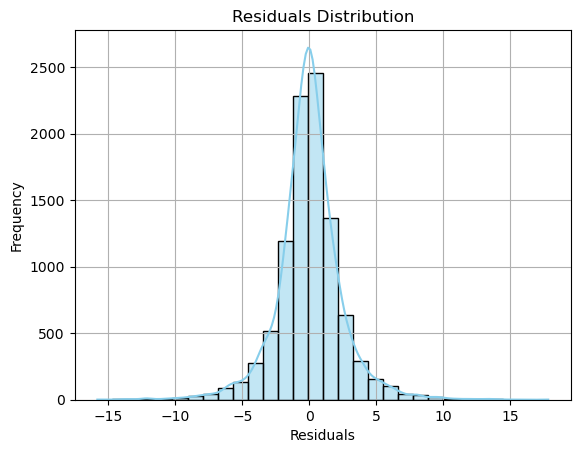

In [31]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot the histogram with KDE for residuals (y_test - predictions)
sns.histplot(y_test - predictions, kde=True, color="skyblue", bins=30)

# Customize the plot
plt.xlabel("Residuals")
plt.ylabel("Frequency")
plt.title("Residuals Distribution")
plt.grid(True)  # Optional: Add gridlines for better readability

# Show the plot
plt.show()


In [32]:
import plotly.express as px

# Create a scatter plot
fig = px.scatter(
    x=y_test,  # Actual values
    y=predictions,  # Predicted values
    labels={"x": "Actual Values", "y": "Predicted Values"},  # Axis labels
    title="Actual vs Predicted Values",
    color_discrete_sequence=["blue"],  # Color of the points
)

# Add a reference line (y = x) for perfect predictions
fig.add_shape(
    type="line",
    x0=min(y_test), x1=max(y_test),
    y0=min(y_test), y1=max(y_test),
    line=dict(color="red", width=2, dash="dash"),  # Customize line style
)

# Customize layout
fig.update_layout(
    xaxis_title="Actual Values",
    yaxis_title="Predicted Values",
    width=800,
    height=600,
)

# Show the plot
fig.show()


# Saving The Model

In [29]:
# Save Model and Encoders
joblib.dump({"model": model, "encoders": encoders}, 'random_forest_model.pkl')

['random_forest_model.pkl']